In [1]:
import cellPLATO as cp

import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

OVERWRITE_DATAFRAMES = False

Finished running cellPLATO initialization and loaded config.
Initializing:  Fig1_PBMCderivedeNKsICAM_10_4_2022
Hypthesis testing using:  st.ttest_ind
Plots will be exported to:  D:/Michael_Shannon/CELLPLATO_MASTER/FIGURE_1_ALT_OUTPUT/Fig1_PBMCderivedeNKsICAM_10_4_2022\2022-10-05_15-14-57-909880\plots/
Using unique embedding per dataset shortname:  Fig1_PBMCderivedeNKsICAM_10_4_2022
Exporting static Superplots
Exporting static Plots of Differences
Exporting static Marginal scatterplots
Exporting static Timeplots
Exporting Bar plots
Using corresponding CTL_SHORTLABEL:  eNKs  for condition:  Condition_PBMCeNK_20x
Dataset in current notebook:  Fig1_PBMCderivedeNKsICAM_10_4_2022
Finished initializing data_processing
Finished intializing visualizations
Finished initializing cellPLATO


In [2]:
if os.path.exists(cp.SAVED_DATA_PATH + 'dr_df.csv'):

    
    comb_df = pd.read_csv(cp.SAVED_DATA_PATH + 'comb_df.csv')
    dr_df = pd.read_csv(cp.SAVED_DATA_PATH + 'dr_df.csv')
    lab_dr_df = pd.read_csv(cp.SAVED_DATA_PATH + 'lab_dr_df.csv')
    tavg_df = pd.read_csv(cp.SAVED_DATA_PATH + 'tavg_df.csv')
    lab_dr_df


##### Visualize the existing Dimensionaly-Reduced data prior to finetuning the parameters


['eNKs' 'eNKs CytoD']


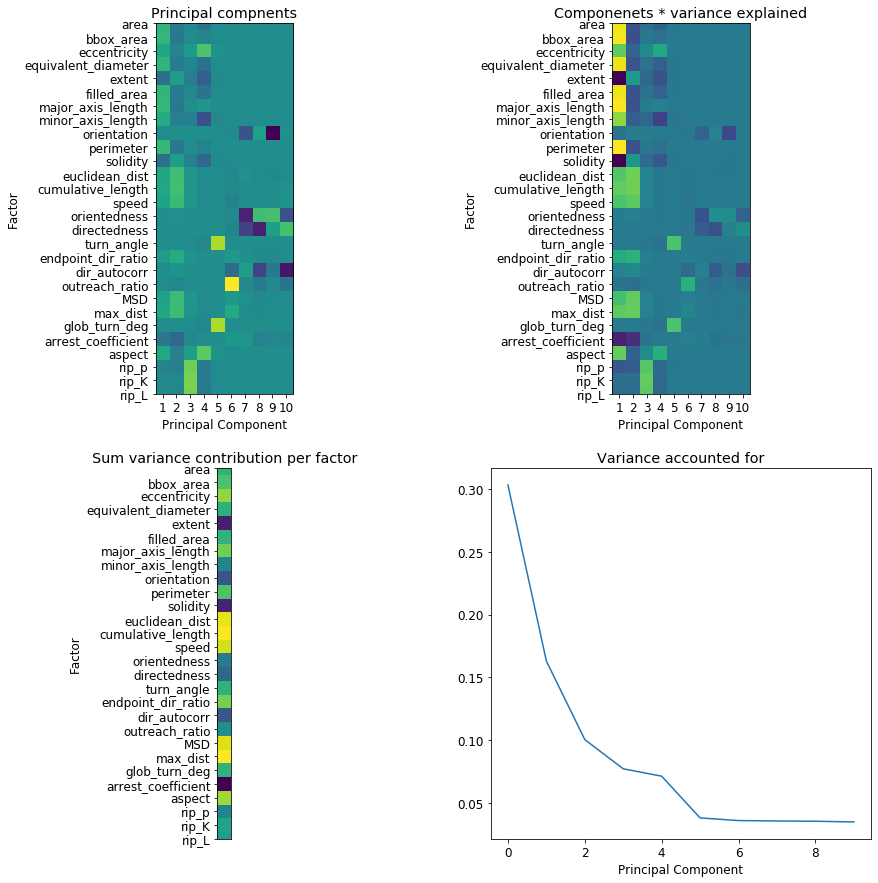

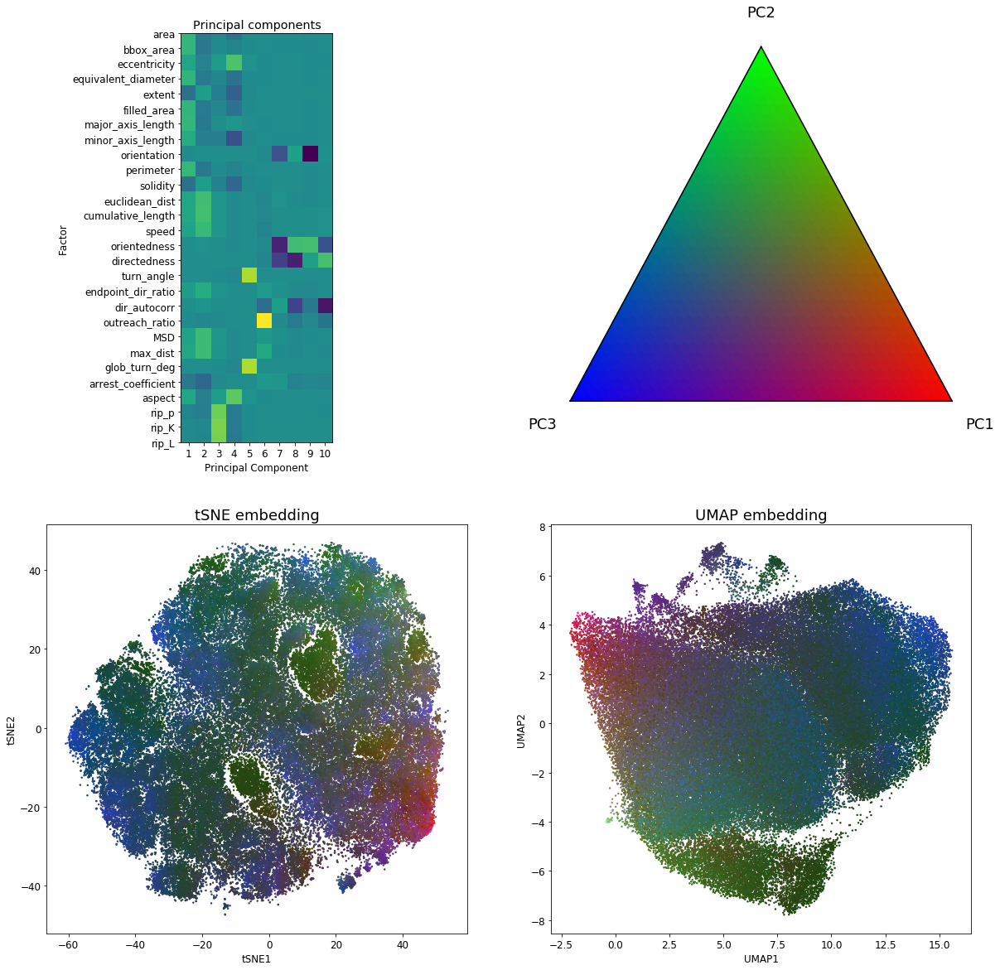

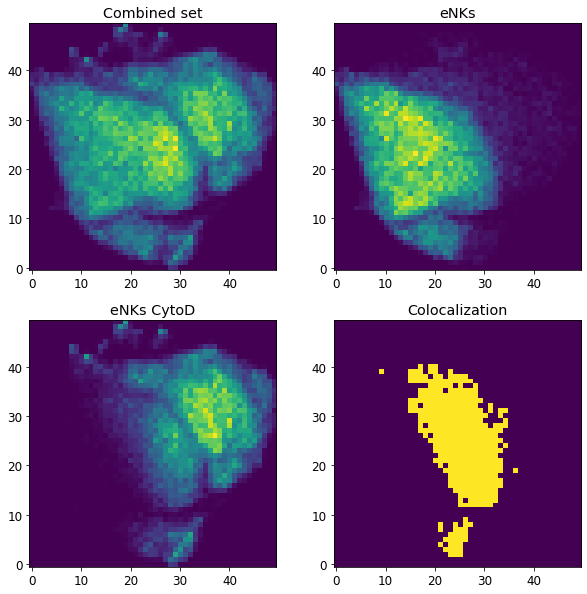

In [3]:
pca_df, components, expl = cp.do_pca(comb_df[cp.DR_FACTORS])
f = cp.pca_factor_vis(dr_df,pca_tuple=[pca_df, components, expl])#cp.DR_FACTORS)
f = cp.dimension_reduction_subplots(dr_df,pca_tuple=[pca_df, components, expl])
f = cp.spatial_img_coloc(dr_df, xy='umap',thresh=10,n_bins=50)

['eNKs' 'eNKs CytoD']


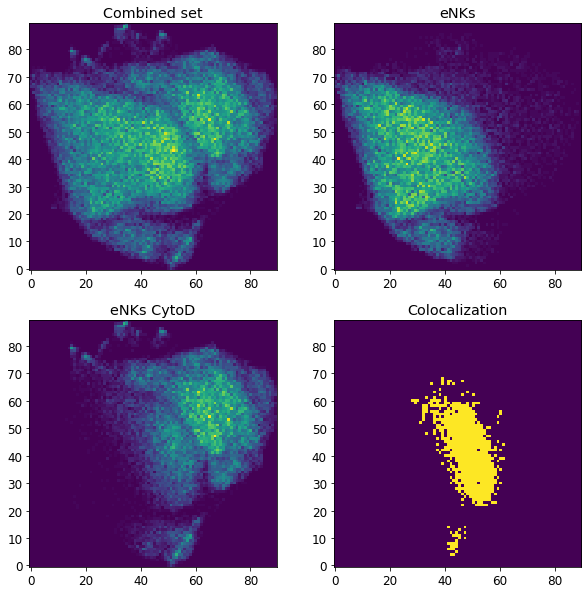

In [4]:
f =cp.spatial_img_coloc(lab_dr_df, xy='UMAP',thresh=6,n_bins=90)

# Filtering upstream of Dimensionality Reduction

Applying filters:
{'area': (10, 10000), 'ntpts': (12, 1800)}
Beginning filtering ...
99603  data points from  1765  cells
Applying filters to entire cell trajectory:
{'area': (10, 10000), 'ntpts': (12, 1800)}
...
 Finished filtering. Resulting dataframe contains:
99603  data points from  1765  cells


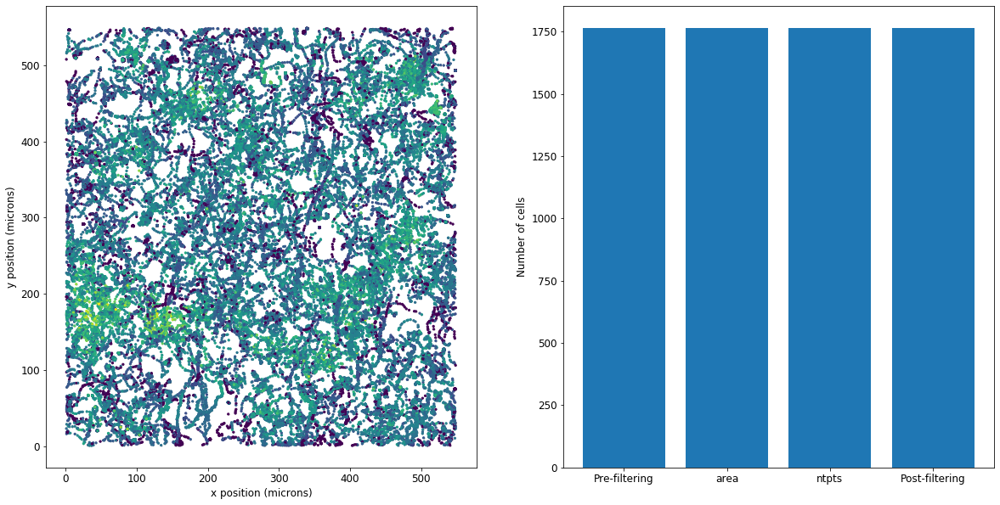

In [5]:
# User-defined filters in dict {factor:(min, max)}
data_filters = {
#   "speed": (10, 100),
   "area": (10, 10000), # Warning: range will change if self-normalized
  "ntpts": (12,1800)
}

# Returns a filtered dataframe, while also adding included column to comb_df
filt_df, filt_counts = cp.apply_filters(comb_df,filter_dict=data_filters)

fig = cp.visualize_filtering(comb_df, filt_counts)

In [6]:
comb_df = filt_df

In [7]:
UMAP_MIN_DIST = 0.05

min_dist = 0.05

---
Running dr_pipeline...
tSNE perplexity =  100.0
UMAP nearest neighbors =  10.0  min distance =  0.2
Using standardized factors for dimensionality reduction, matrix shape:  (99603, 28)
Using openTSNE with perplexity =  100.0
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
dbscan_clustering() with eps =  0.023
DBScan clustering by UMAP...
Clustering generated: 130 subgoups.
dbscan sweep of  umap  with eps:  0.023 generated cluster count of:  130
dbscan_clustering() with eps =  0.025
DBScan clustering by UMAP...
Clustering generated: 89 subgoups.
dbscan sweep of  umap  with eps:  0.025 generated cluster count of:  89
dbscan_clustering() with eps =  0.023
DBScan clustering by tSNE...
Clustering generated: 237 subgoups.
dbscan sweep of  tsne  with eps:  0.023 generated cluster count of:  237
Failed to draw cluster, failed to draw cluster:  42  with shape:  (12, 2)
Failed to draw cluster, failed to draw cluster:  66  with shape:  (11, 2)
Failed to d

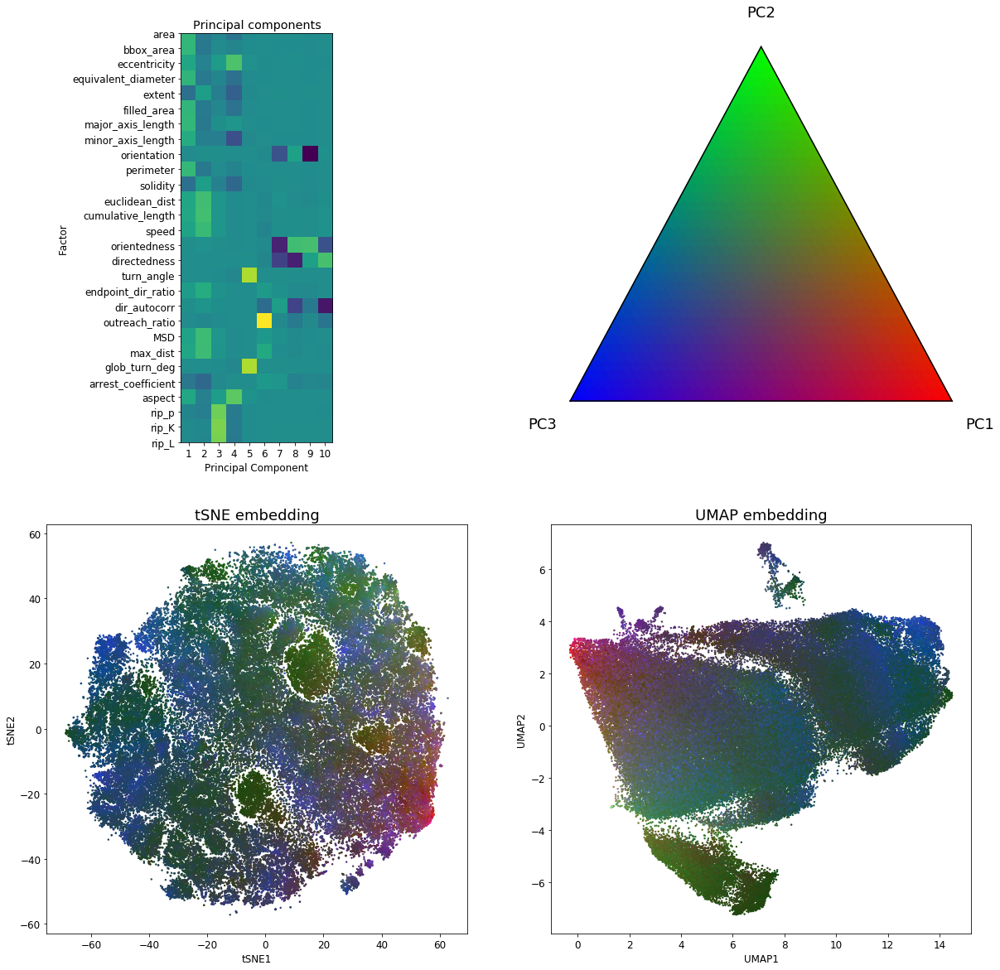

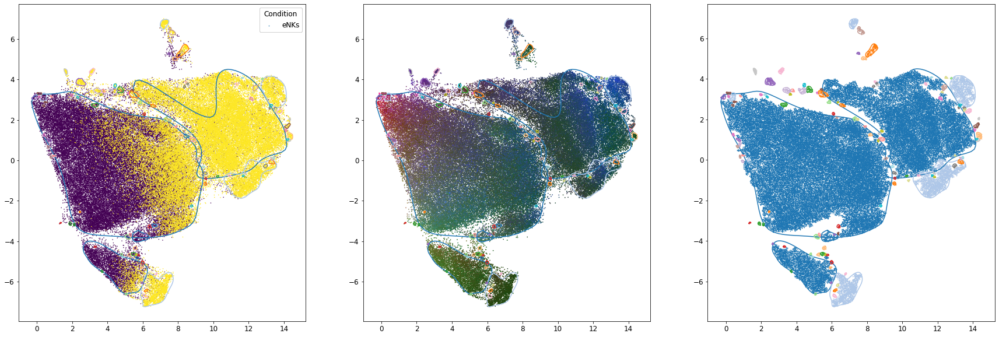

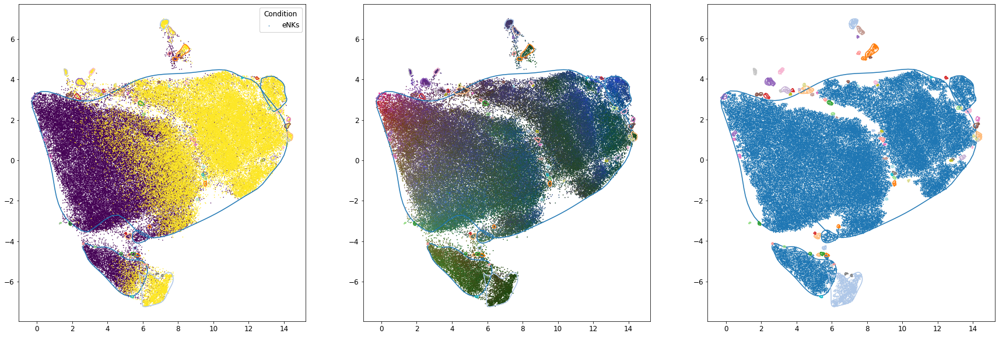

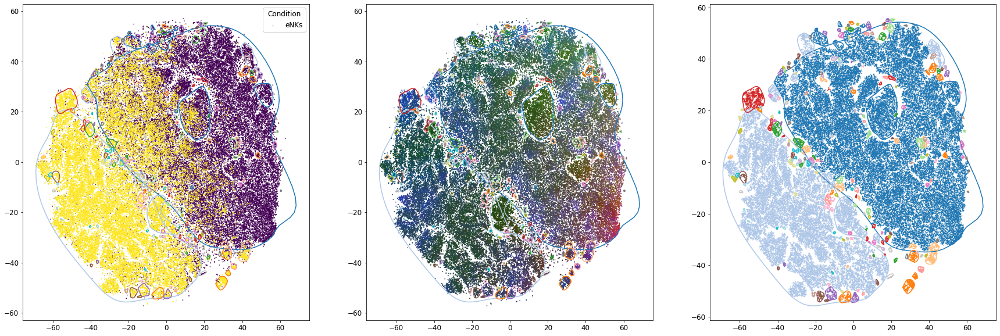

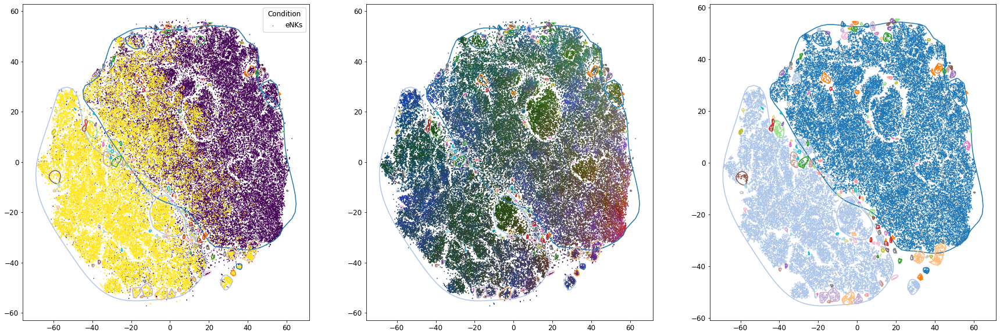

...

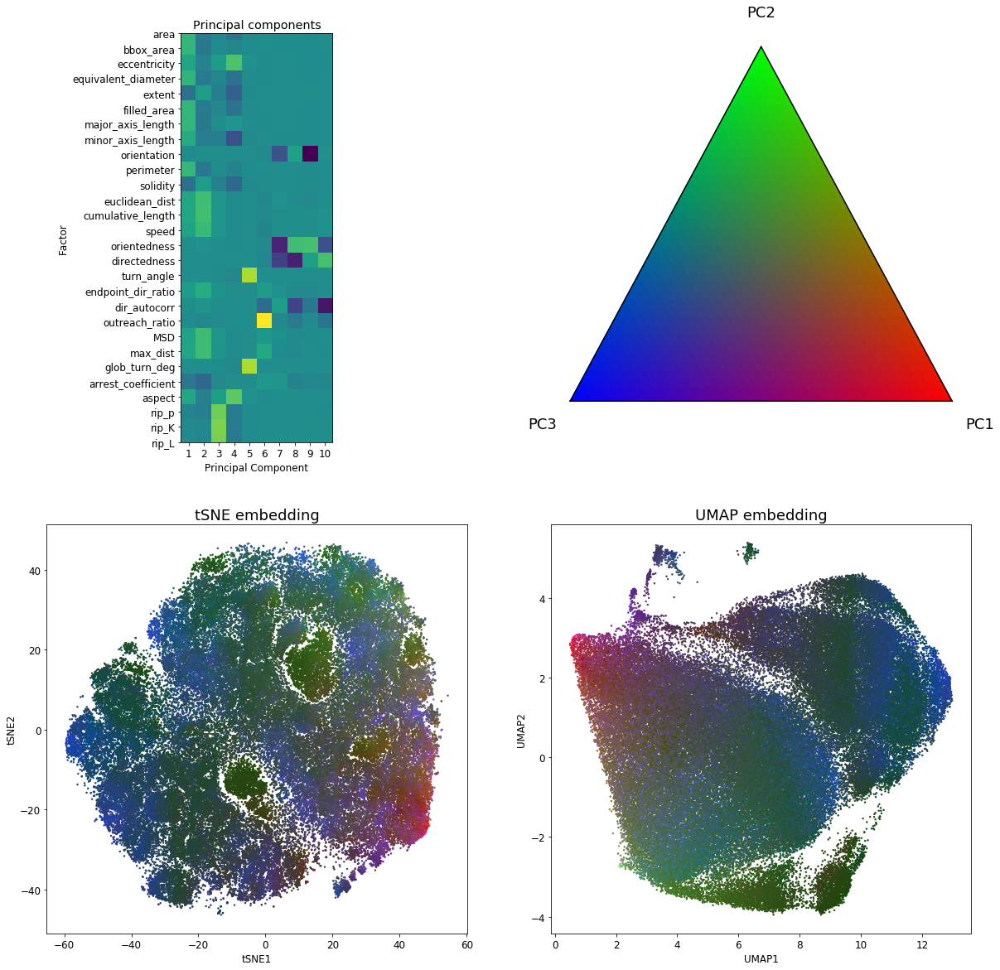

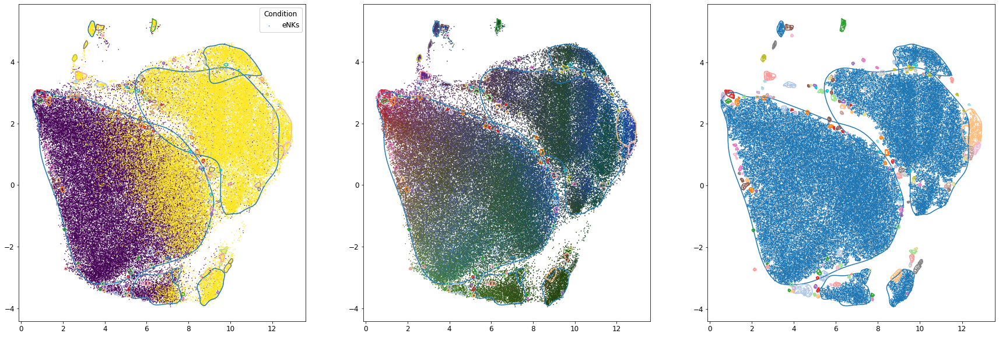

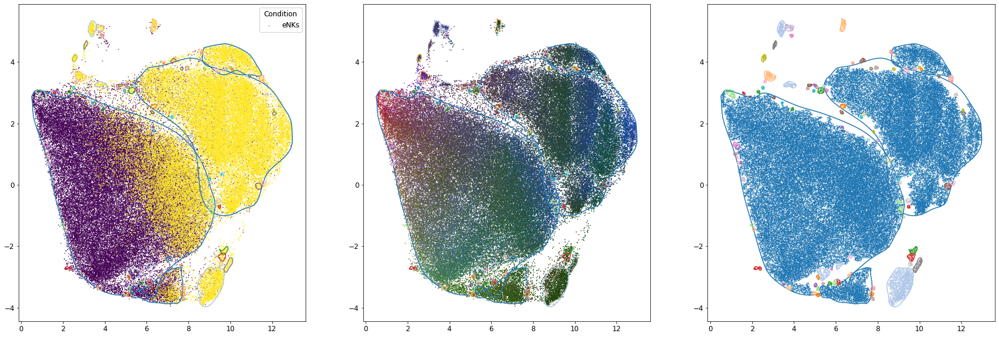

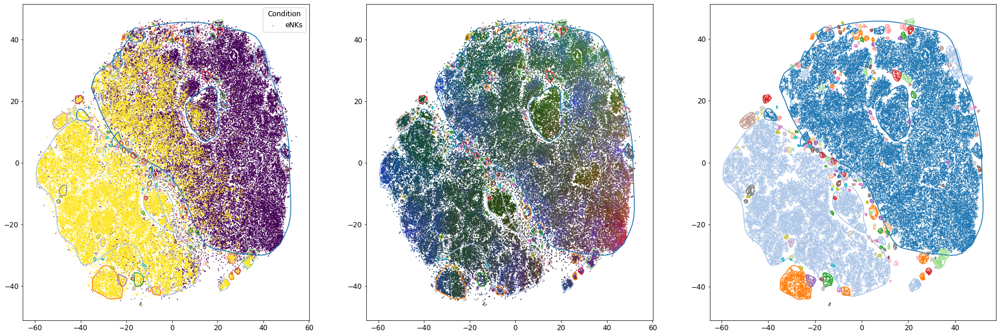

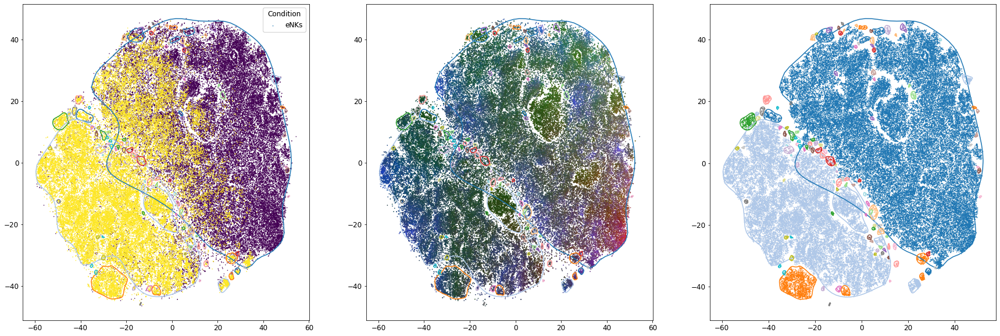

In [9]:
# Simultaneously sweep a range of critical parameters for tSNE and UMAP embeddings.
epsyo = [0.023,0.025]

# UMAP_MIN_DIST = 0.1

# min_dist = 0.1

cp.sweep_tsne_umap(comb_df, 
                perp_min_max=(100,185), 
                nn_min_max=(10,50),
                n_vals=4,
                nested_dbscan_sweep=True,  
                dr_factors=cp.DR_FACTORS, 
                eps_vals=epsyo) #cp.EPS


# Dimensionality Reduction: Parameter sweeping and tuning

Running dr_pipeline...
tSNE perplexity =  185
UMAP nearest neighbors =  50  min distance =  0.2
Using standardized factors for dimensionality reduction, matrix shape:  (99603, 28)
Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
['eNKs' 'eNKs CytoD']


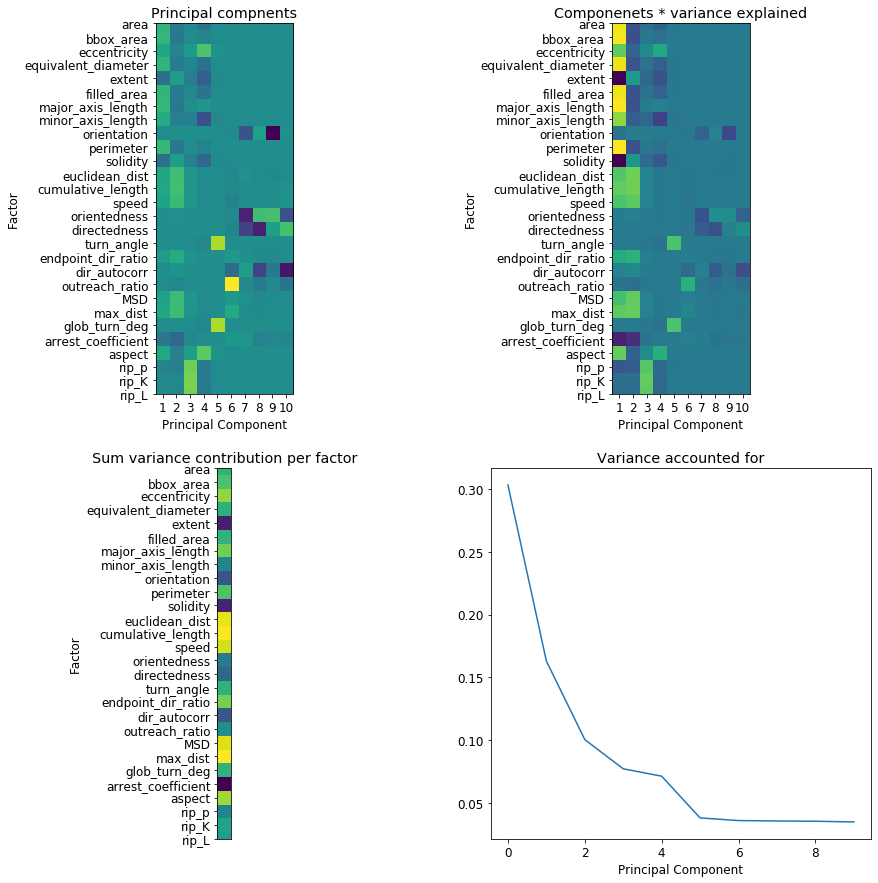

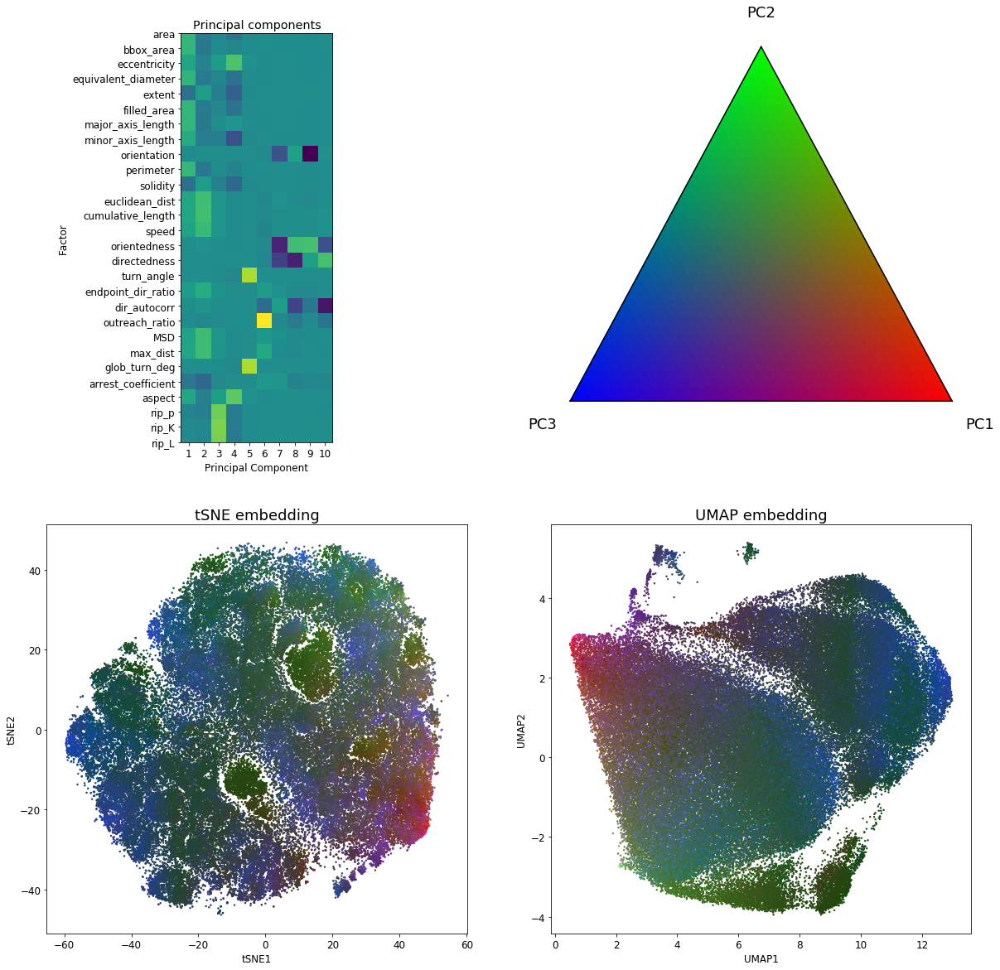

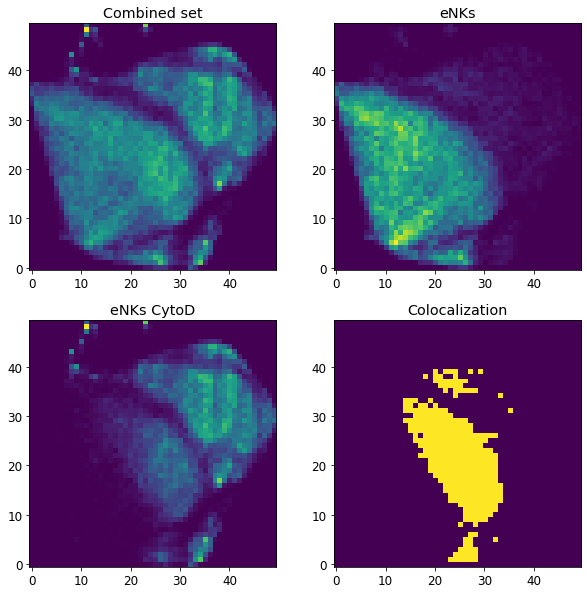

In [10]:
# Now re-do the dimensionality reduction with selected parameters:

# Replace these values with the ones found from the previous sweep
perplexity= 185
umap_nn= 50
min_dist= 0.2

# perplexity = cp.TSNE_PERP #Defaults from config
# umap_nn = cp.UMAP_NN
# min_dist = cp.UMAP_MIN_DIST

pca_df, components, expl = cp.do_pca(comb_df[cp.DR_FACTORS])

dr_df = cp.dr_pipeline(comb_df, 
                    dr_factors=cp.DR_FACTORS,
                    tsne_perp=perplexity,
                    umap_nn=umap_nn,
                    min_dist=min_dist) 

f = cp.pca_factor_vis(dr_df,pca_tuple=[pca_df, components, expl])#cp.DR_FACTORS)
f = cp.dimension_reduction_subplots(dr_df,pca_tuple=[pca_df, components, expl])
f = cp.spatial_img_coloc(dr_df, xy='umap',thresh=10,n_bins=50)

##### Visualizat the Migration and Shape characteristic separately in low-dimensional embeddings

Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by tSNE...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by tSNE...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by tSNE...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by UMAP...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by UMAP...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by UMAP...


<Figure size 720x720 with 0 Axes>

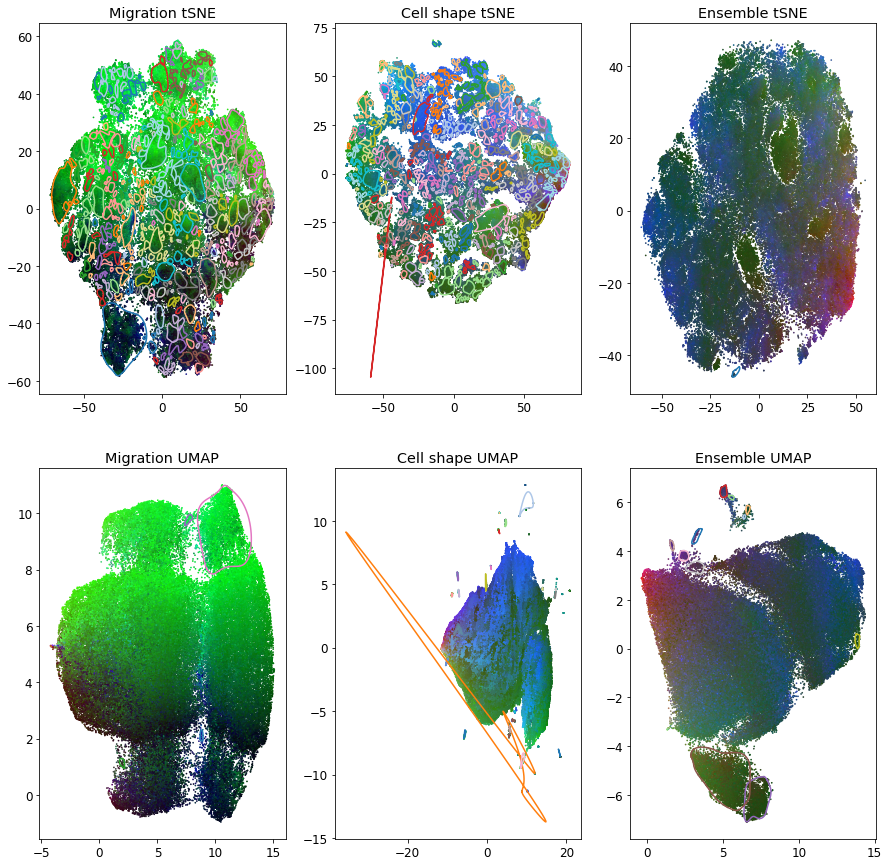

In [11]:
'''
A great improvement will be to colormap by PC values (triangular)
and add make cluster contours for each group.  (hdbscan)
'''

cp.compare_mig_shape_factors(comb_df,
                          dr_factors_mig=cp.MIG_FACTORS,
                          dr_factors_shape=cp.REGIONPROPS_LIST, 
                          dr_factors_all=cp.MIG_FACTORS+cp.REGIONPROPS_LIST+cp.ADDITIONAL_FACTORS
                         )
                       

##### If hdbscan is not performing well on this data, try using DBscan and sweeping eps values

dbscan_clustering() with eps =  0.023
DBScan clustering by UMAP...
Clustering generated: 169 subgoups.
eps:  0.023  clusters:  169
dbscan_clustering() with eps =  0.025
DBScan clustering by UMAP...
Clustering generated: 113 subgoups.
eps:  0.025  clusters:  113
dbscan_clustering() with eps =  0.023
DBScan clustering by tSNE...
Clustering generated: 208 subgoups.
eps:  0.023  clusters:  208
dbscan_clustering() with eps =  0.025
DBScan clustering by tSNE...
Clustering generated: 132 subgoups.
eps:  0.025  clusters:  132
Failed to draw cluster, failed to draw cluster:  95  with shape:  (21, 2)
Failed to draw cluster, failed to draw cluster:  95  with shape:  (21, 2)
Failed to draw cluster, failed to draw cluster:  95  with shape:  (21, 2)
Finished sweeping dbscan clustering. See output directory:  D:/Michael_Shannon/CELLPLATO_MASTER/FIGURE_1_ALT_OUTPUT/Fig1_PBMCderivedeNKsICAM_10_4_2022\2022-10-05_15-14-57-909880\plots/Clustering/Parameter_sweep/


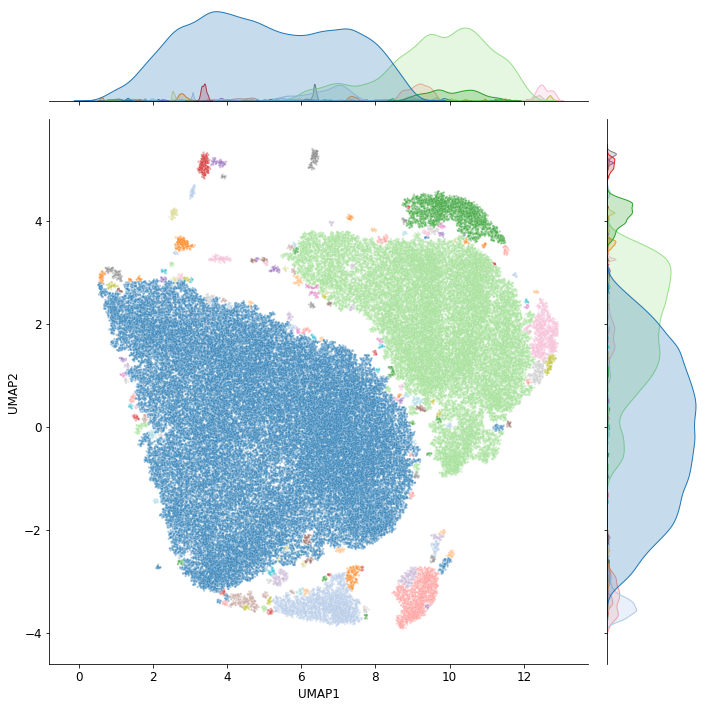

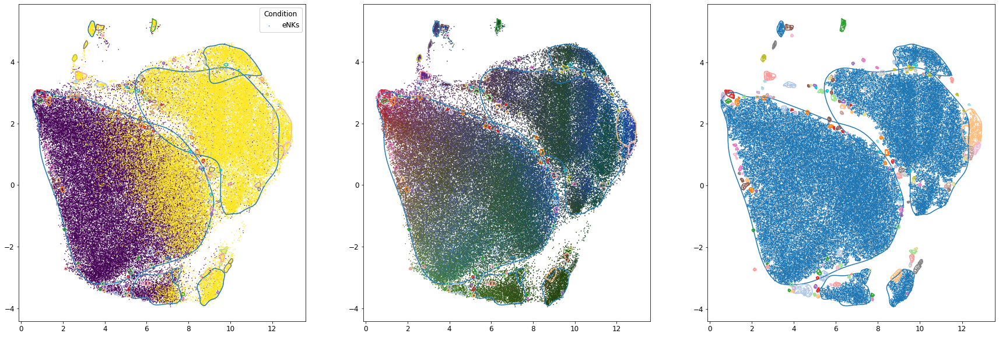

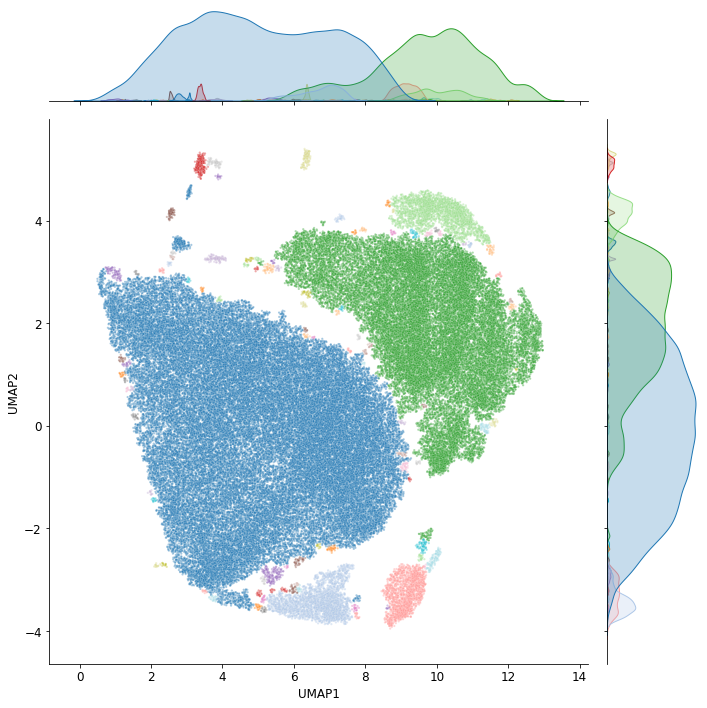

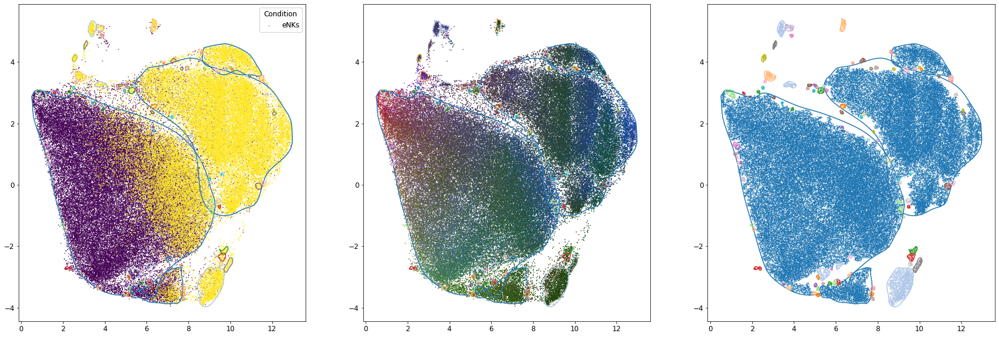

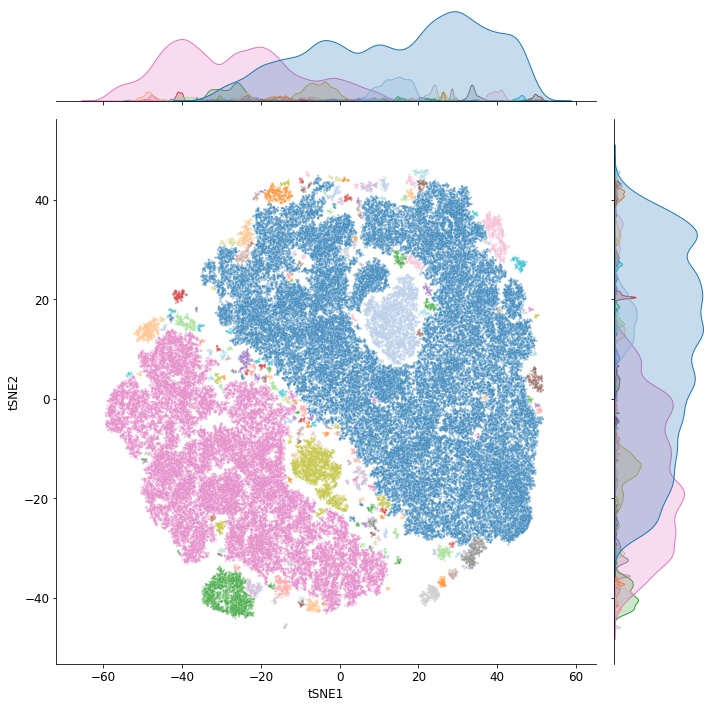

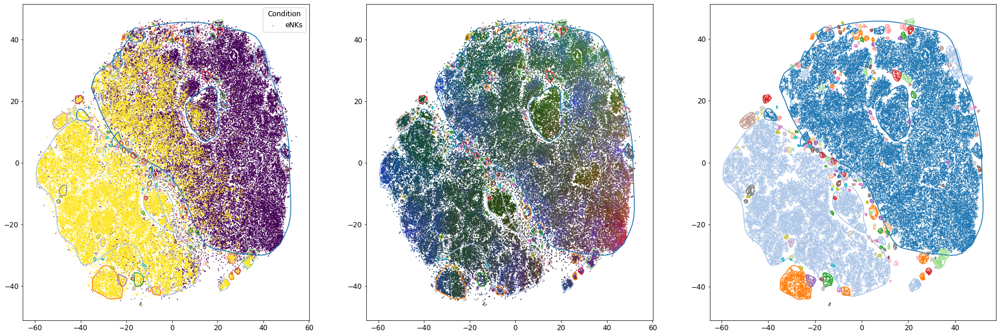

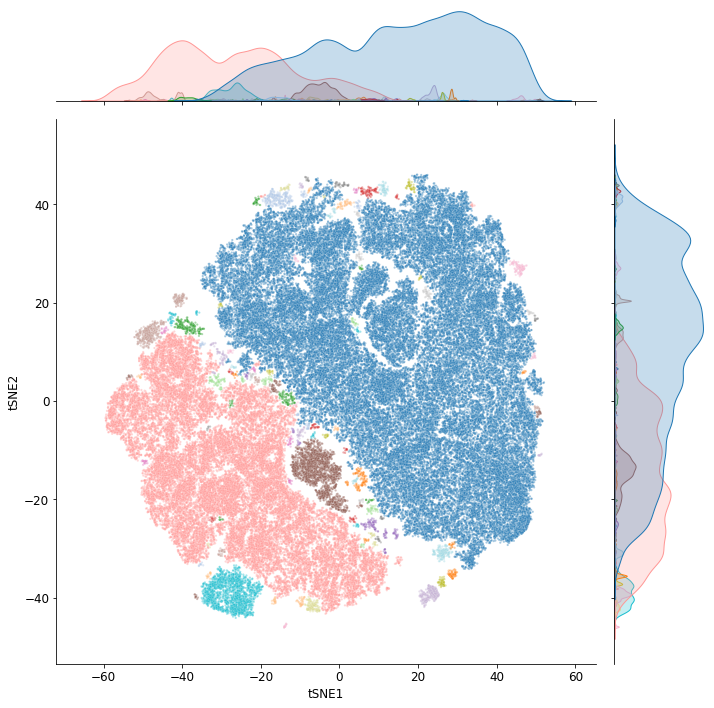

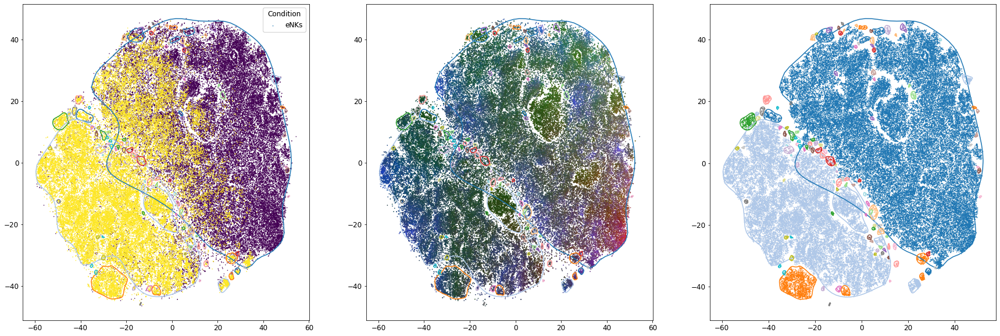

In [12]:

# Define the range of eps values to sweep across
eps_low = 0.023  # lower value
eps_high = 0.025  # upper value
eps_n = 2   # how many iterations (how many plots to generate)

eps_vals = np.round(np.linspace(eps_low, eps_high, eps_n),3)      

methods = ['umap', 'tsne']

for dr_method in methods:    
    for eps in eps_vals:

        lab_dr_df = cp.dbscan_clustering(dr_df,eps=eps,cluster_by=dr_method, plot=True)
        print('eps: ', eps, ' clusters: ', len(lab_dr_df['label'].unique()))
        fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=[30,10])
        cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='condition',legend=False,ax=ax1,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'condition')
        cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='PCs',ax=ax2,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'pca')
        cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='cluster',ax=ax3,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'cluster')

        fig.show()

        if cp.STATIC_PLOTS:
            plt.savefig(cp.CLUST_PARAMS_DIR+dr_method+'_sweep_eps_'+str(eps)+'nclusters_'+str(len(lab_dr_df['label'].unique()))+'.png', dpi=300)

print('Finished sweeping dbscan clustering. See output directory: ',cp.CLUST_PARAMS_DIR)          
            



dbscan_clustering() with eps =  0.025
DBScan clustering by UMAP...
Clustering generated: 113 subgoups.


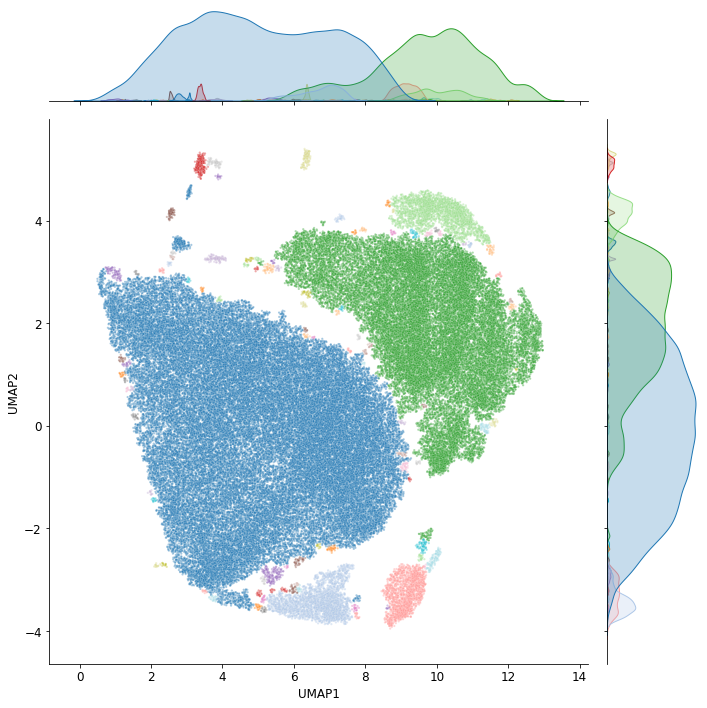

In [13]:
'''
Add here a very clear, intentional step where the lab_dr_df is generated with the
parameters sweeped in the notebook above. 
'''
# eps = None
eps = 0.025
dr_method = 'umap'

if eps is None:
    lab_dr_df = cp.hdbscan_clustering(dr_df,cluster_by=dr_method, plot=False)

else:
        
    lab_dr_df = cp.dbscan_clustering(dr_df,eps=eps,cluster_by=dr_method, plot=True)
# 

### Filtering downstream of dimensionality reduction

##### Example filtering usage (ALL):
    Find cells that maintained a speed between 5-100um/min throughout their trajectory. 

In [ ]:
# Filter after dimensionality reduction
filters = {
#   "tSNE1": (-100, 100), 
#   "tSNE2": (-100, 100), 
#   "area": (200, 600), 
  "area": (10, 10000), # Warning: range will change if self-normalized
  "ntpts": (12,180)
#     "endpoint_dir_ratio": (0.35,1)
}

# Apply the post-dimensionality reduction filters and visualize the results.
filt_dr_df, filt_list = cp.apply_filters(lab_dr_df,how='all', filter_dict=filters) # 'all is default behaviour', can be left out. 
fig = cp.visualize_filtering(lab_dr_df, filt_list, plot_by='umap') #Visualize filtering needs extended to show a metric of interest

In [ ]:
# Process a time-averaged DataFrame
tavg_df2 = cp.time_average(filt_dr_df)
display(tavg_df2)

In [ ]:
factor ='speed'
# Time-averaged superplots
cp.superplots_plotly(tavg_df, factor, t='timeaverage')

In [ ]:
factor ='speed'
# Time-averaged superplots
cp.superplots_plotly(tavg_df2, factor, t='timeaverage')

In [ ]:
fig = cp.visualize_filtering(lab_dr_df, filt_list)

In [ ]:
# Optional:

# dr_df = filt_dr_df

Example filtering usage (sequential-ANY):¶
- Of those cells, find the ones that had a specific cluster ID at some point in their trajectory. 

In [ ]:
# Filter cells that were a part of clusterid == 5 at some point in their trajectory.
filters = {
  "label": (5, 5) 
}

'''
To apply sequentially, pass the results of the previous filtering operation to apply_filters()
    filt_dr_df
    
To see influence of new 'any' filter in isolation, use lab_dr_df as input.
''' 

filt_dr_df, filt_list = cp.apply_filters(lab_dr_df,how='any', filter_dict=filters) # 'all' is default behaviour
fig = cp.visualize_filtering(lab_dr_df, filt_list, plot_by='umap')

In [ ]:
'''
Optionally, save the results of this fine-tuning to the shared data folder
so the new results can be used by other notebooks.
'''

if OVERWRITE_DATAFRAMES:
    # Save dataframes to shared data folder
    tavg_df.to_csv(cp.SAVED_DATA_PATH + 'tavg_df.csv')
    comb_df.to_csv(cp.SAVED_DATA_PATH + 'comb_df.csv')
    dr_df.to_csv(cp.SAVED_DATA_PATH + 'dr_df.csv')
    lab_dr_df.to_csv(cp.SAVED_DATA_PATH + 'lab_dr_df.csv')